In this notebook, we will build a 3D map of a scene from a small set of images and then localize an image downloaded from the Internet. This demo was contributed by [Philipp Lindenberger](https://github.com/Phil26AT/).

In [5]:
%load_ext autoreload
%autoreload 2
import tqdm, tqdm.notebook

tqdm.tqdm = tqdm.notebook.tqdm  # notebook-friendly progress bars
from pathlib import Path
import numpy as np

from hloc import (
    extract_features,
    match_features,
    reconstruction,
    visualization,
    pairs_from_exhaustive,
)
from hloc.visualization import plot_images, read_image
from hloc.utils import viz_3d

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Setup
Here we define some output paths.

In [8]:
# images = Path("datasets/sacre_coeur")
images = Path("/home/otter77/Pictures/glacier_full")
outputs = Path("outputs/demo/")
!rm -rf $outputs
sfm_pairs = outputs / "pairs-sfm.txt"
loc_pairs = outputs / "pairs-loc.txt"
sfm_dir = outputs / "sfm"
features = outputs / "features.h5"
matches = outputs / "matches.h5"

feature_conf = extract_features.confs['superpoint_aachen']
matcher_conf = match_features.confs['superpoint+lightglue']

# 3D mapping
First we list the images used for mapping. These are all day-time shots of Sacre Coeur.

In [9]:
# references = [p.relative_to(images).as_posix() for p in (images / "mapping/").iterdir()]
# print(len(references), "mapping images")
# plot_images([read_image(images / r) for r in references], dpi=25)

references = [p.relative_to(images).as_posix() for p in (images / "images/").iterdir()]
print(len(references), "mapping images")

589 mapping images


Then we extract features and match them across image pairs. Since we deal with few images, we simply match all pairs exhaustively. For larger scenes, we would use image retrieval, as demonstrated in the other notebooks.

In [10]:
extract_features.main(
    feature_conf, images, image_list=references, feature_path=features
)
pairs_from_exhaustive.main(sfm_pairs, image_list=references)
match_features.main(matcher_conf, sfm_pairs, features=features, matches=matches);

[2025/10/01 16:46:57 hloc INFO] Extracting local features with configuration:
{'model': {'max_keypoints': 4096, 'name': 'superpoint', 'nms_radius': 3},
 'output': 'feats-superpoint-n4096-r1024',
 'preprocessing': {'grayscale': True, 'resize_max': 1024}}


Loaded SuperPoint model


  0%|          | 0/589 [00:00<?, ?it/s]

[2025/10/01 16:47:20 hloc INFO] Finished exporting features.
[2025/10/01 16:47:20 hloc INFO] Found 173166 pairs.
[2025/10/01 16:47:20 hloc INFO] Matching local features with configuration:
{'model': {'features': 'superpoint', 'name': 'lightglue'},
 'output': 'matches-superpoint-lightglue'}


  0%|          | 0/173166 [00:00<?, ?it/s]

[2025/10/01 17:38:59 hloc INFO] Finished exporting matches.


The we run incremental Structure-From-Motion and display the reconstructed 3D model.

In [12]:
model = reconstruction.main(
    sfm_dir, images, sfm_pairs, features, matches, image_list=references
)
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(
    fig, model, color="rgba(255,0,0,0.5)", name="images", points_rgb=True
)
fig.show()

[2025/10/01 17:41:36 hloc INFO] Writing COLMAP logs to outputs/demo/sfm/colmap.LOG.*
[2025/10/01 17:41:36 hloc WARNING] The database already exists, deleting it.
[2025/10/01 17:41:36 hloc INFO] Creating an empty database...
[2025/10/01 17:41:36 hloc INFO] Importing images into the database...
[2025/10/01 17:42:05 hloc INFO] Importing features into the database...


  0%|          | 0/589 [00:00<?, ?it/s]

[2025/10/01 17:42:05 hloc INFO] Importing matches into the database...


  0%|          | 0/173166 [00:00<?, ?it/s]

[2025/10/01 17:42:49 hloc INFO] Performing geometric verification of the matches...
[2025/10/01 18:20:09 hloc INFO] Running 3D reconstruction...


Reconstruction 0:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 1:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 2:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 3:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 4:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 5:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 6:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 7:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 8:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 9:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 10:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 11:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 12:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 13:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 14:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 15:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 16:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 17:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 18:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 19:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 20:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 21:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 22:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 23:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 24:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 25:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 26:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 27:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 28:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 29:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 30:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 31:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 32:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 33:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 34:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 35:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 36:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 37:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 38:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 39:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 40:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 41:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 42:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 43:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 44:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 45:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 46:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 47:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 48:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 49:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 50:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 51:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 52:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 53:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 54:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 55:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 56:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 57:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 58:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 59:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 60:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 61:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 62:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 63:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 64:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 65:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 66:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 67:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 68:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 69:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 70:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 71:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 72:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 73:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 74:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 75:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 76:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 77:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 78:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 79:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 80:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 81:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 82:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 83:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 84:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 85:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 86:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 87:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 88:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 89:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 90:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 91:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 92:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 93:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 94:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 95:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 96:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 97:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 98:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 99:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 100:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 101:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 102:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 103:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 104:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 105:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 106:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 107:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 108:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 109:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 110:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 111:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 112:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 113:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 114:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 115:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 116:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 117:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 118:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 119:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 120:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 121:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 122:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 123:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 124:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 125:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 126:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 127:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 128:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 129:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 130:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 131:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 132:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 133:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 134:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 135:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 136:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 137:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 138:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 139:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 140:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 141:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 142:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 143:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 144:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 145:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 146:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 147:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 148:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 149:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 150:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 151:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 152:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 153:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 154:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 155:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 156:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 157:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 158:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 159:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 160:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 161:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 162:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 163:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 164:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 165:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 166:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 167:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 168:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 169:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 170:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 171:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 172:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 173:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 174:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 175:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 176:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 177:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 178:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 179:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 180:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 181:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 182:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 183:   0%|          | 0/589 [00:00<?, ?images/s, registered]

Reconstruction 184:   0%|          | 0/589 [00:00<?, ?images/s, registered]

[2025/10/01 18:49:31 hloc INFO] Reconstructed 2 model(s).
[2025/10/01 18:49:31 hloc INFO] Largest model is #0 with 513 images.
[2025/10/01 18:49:31 hloc INFO] Reconstruction statistics:
Reconstruction:
	num_rigs = 1
	num_cameras = 1
	num_frames = 513
	num_reg_frames = 513
	num_images = 513
	num_points3D = 153808
	num_observations = 900741
	mean_track_length = 5.85627
	mean_observations_per_image = 1755.83
	mean_reprojection_error = 1.54424
	num_input_images = 589


In [13]:
fig = viz_3d.init_figure()
viz_3d.plot_reconstruction(
    fig, model, color="rgba(255,0,0,0.5)", name="images", points_rgb=True
)
fig.show()

We also visualize which keypoints were triangulated into the 3D model.

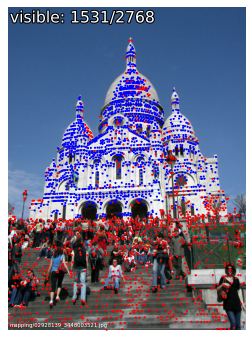

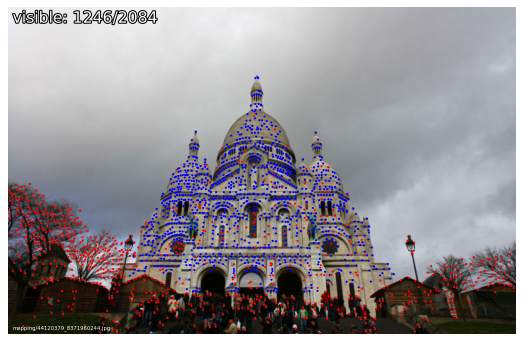

In [6]:
visualization.visualize_sfm_2d(model, images, color_by="visibility", n=2)

# Localization
Now that we have a 3D map of the scene, we can localize any image. To demonstrate this, we download [a night-time image from Wikimedia](https://commons.wikimedia.org/wiki/File:Paris_-_Basilique_du_Sacr%C3%A9_Coeur,_Montmartre_-_panoramio.jpg).

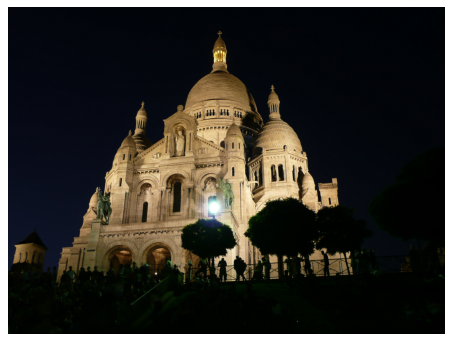

In [7]:
url = "https://upload.wikimedia.org/wikipedia/commons/5/53/Paris_-_Basilique_du_Sacr%C3%A9_Coeur%2C_Montmartre_-_panoramio.jpg"
# try other queries by uncommenting their url
# url = "https://upload.wikimedia.org/wikipedia/commons/5/59/Basilique_du_Sacr%C3%A9-C%C5%93ur_%285430392880%29.jpg"
# url = "https://upload.wikimedia.org/wikipedia/commons/8/8e/Sacr%C3%A9_C%C5%93ur_at_night%21_%285865355326%29.jpg"
query = "query/night.jpg"
!mkdir -p $images/query && wget $url -O $images/$query -q
plot_images([read_image(images / query)], dpi=75)

Again, we extract features for the query and match them exhaustively.

In [8]:
extract_features.main(
    feature_conf, images, image_list=[query], feature_path=features, overwrite=True
)
pairs_from_exhaustive.main(loc_pairs, image_list=[query], ref_list=references)
match_features.main(
    matcher_conf, loc_pairs, features=features, matches=matches, overwrite=True
);

[2025/07/21 19:08:43 hloc INFO] Extracting local features with configuration:
{'model': {'model_name': 'aliked-n16', 'name': 'aliked'},
 'output': 'feats-aliked-n16',
 'preprocessing': {'grayscale': False, 'resize_max': 1024}}


  0%|          | 0/1 [00:00<?, ?it/s]

[2025/07/21 19:08:43 hloc INFO] Finished exporting features.
[2025/07/21 19:08:43 hloc INFO] Found 10 pairs.
[2025/07/21 19:08:43 hloc INFO] Matching local features with configuration:
{'model': {'features': 'aliked', 'name': 'lightglue'},
 'output': 'matches-aliked-lightglue'}


  0%|          | 0/10 [00:00<?, ?it/s]

[2025/07/21 19:08:44 hloc INFO] Finished exporting matches.


We read the EXIF data of the query to infer a rough initial estimate of camera parameters like the focal length. Then we estimate the absolute camera pose using PnP+RANSAC and refine the camera parameters.

found 1171/1938 inlier correspondences.


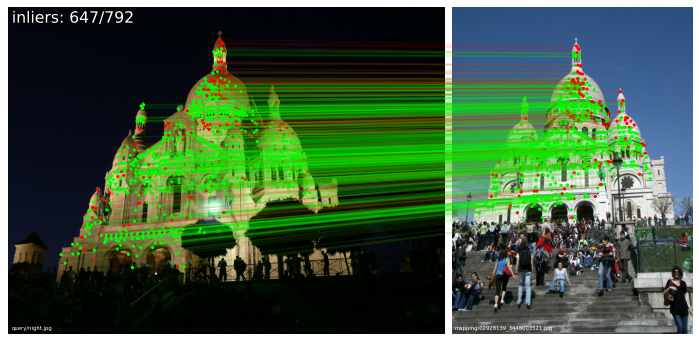

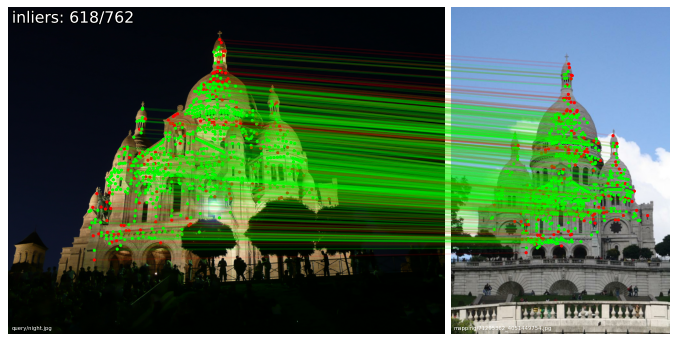

In [9]:
import pycolmap
from hloc.localize_sfm import QueryLocalizer, pose_from_cluster

camera = pycolmap.infer_camera_from_image(images / query)
ref_ids = [model.find_image_with_name(r).image_id for r in references]
conf = {
    "estimation": {"ransac": {"max_error": 12}},
    "refinement": {"refine_focal_length": True, "refine_extra_params": True},
}
localizer = QueryLocalizer(model, conf)
ret, log = pose_from_cluster(localizer, query, camera, ref_ids, features, matches)

print(f'found {ret["num_inliers"]}/{len(ret["inlier_mask"])} inlier correspondences.')
visualization.visualize_loc_from_log(images, query, log, model)

We visualize the correspondences between the query images a few mapping images. We can also visualize the estimated camera pose in the 3D map.

In [ ]:
viz_3d.plot_camera_colmap(
    fig, ret["cam_from_world"], ret["camera"], color="rgba(0,255,0,0.5)", name=query, fill=True,
    text=f"inliers: {ret['num_inliers']} / {ret['inlier_mask'].shape[0]}"
)
# visualize 2D-3D correspodences
inl_3d = np.array(
    [model.points3D[pid].xyz for pid in np.array(log["points3D_ids"])[ret["inlier_mask"]]]
)
viz_3d.plot_points(fig, inl_3d, color="lime", ps=1, name=query)
fig.show()